Let's define the Hyperparametes:
- Training samples(percentages of different samples)
- Grid samples
- Number of hidden layers
- Number of hidden units
- Weight decay
- Weight init(different initializaitions)
- Importance Sampling(True or False)
- Importance Sampling percentage
- batchsize

TO DO List by importance:
- Create script to run a lot of experiments using the hyperparameters
- check the direction of the sdf calculation
- Try if sdf or occupancy is better

In [1]:
from mesh import Mesh


chicken = Mesh('./models/dragon_final.ply')
chicken.mesh.show()

In [2]:
sample = chicken.sample(2**18)
sdf_sample = chicken.calculate_sdf(sample)

In [6]:
# we can sample the volume of Box primitives
points = chicken.mesh.bounding_box_oriented.sample_volume(count=10)

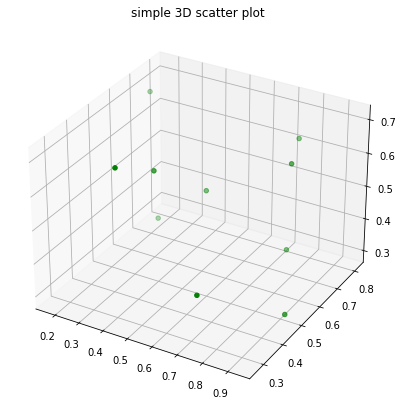

In [7]:
from matplotlib import pyplot as plt

# Creating figure
fig = plt.figure(figsize = (7, 7))
ax = plt.axes(projection ="3d")


# Creating plot
ax.scatter3D(sample[:,0],sample[:,1],sample[:,2], color = 'green')
plt.title("simple 3D scatter plot")
 
# show plot
plt.show()

In [4]:
from tree import Tree

chicken_tree = Tree()
sample.shape

(529530, 3)

In [5]:
import torch
import numpy as np

hidden_layers = 1
hidden_features = 32
maxdepth = 1
weigth_decay = 0
epochs = 50 # To achive this result I 
importance_sampling = False # importance sampling
porcentage_totrain  = 1 # porcentage to use for training 
batchsize = int(sample.shape[0]*0.0024)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

sdf_sample = torch.from_numpy(sdf_sample.astype(np.float32)).to(device)

chicken_tree.train(0,maxdepth,sdf_sample,epochs,3,batchsize,0.001,hidden_layers,hidden_features)

In [6]:
import torch
import numpy as np

In [2]:
from grid import Grid
uniform_grid = Grid(50,chicken.corners)


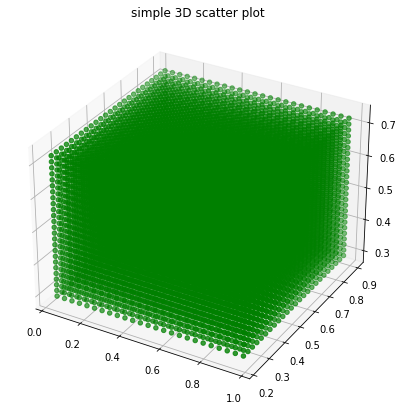

In [8]:
from matplotlib import pyplot as plt

# Creating figure
fig = plt.figure(figsize = (7, 7))
ax = plt.axes(projection ="3d")


# Creating plot
ax.scatter3D(uniform_grid.grid[:,0],uniform_grid.grid[:,1],uniform_grid.grid[:,2], color = 'green')
plt.title("simple 3D scatter plot")
 
# show plot
plt.show()

In [15]:
#uniform_grid.grid = torch.from_numpy(uniform_grid.grid.astype(np.float32)).to(device)

grid_sdf = chicken_tree.evaluate(uniform_grid.grid) # evaluate the tree 
mesh_reconstructed = chicken.reconstruct(grid_sdf,100) # create the mesh
mesh_reconstructed.show()

In [1]:
from metrics import compute_iou

In [2]:
u = compute_iou('./models/dragon_final.ply','not_chicken.ply')

In [4]:
u

tensor(0.0767)

In [ ]:
# Args and hyper parameters for training. 
# k: current depthh
# maxdepth: maximum depth
# inTrain samples: input training set
# epochs
# batchsize
# errorTolerance
# N: number of hidden layers
# H: 'Hight' of layer
# porcentage: porcentage for importance sampling
# weightdecay: weightdecay
# importance_sampling: If you would like to do the sampling

In [10]:
from grid import Grid
import metrics
import torch
#uniform_grid = Grid(250,chicken.corners)
#occ_gt = chicken.calculate_sdf(uniform_grid.grid)
#occ_gt = torch.tensor(metrics.check_mesh_contains(chicken,uniform_grid.grid))
mesh_reconstructed = chicken.reconstruct(occ_gt[:,-1],250) # create the mesh
mesh_reconstructed.show()

In [9]:
occ_gt[:,-1]

array([0.13439451, 0.13368237, 0.13302419, ..., 0.31584096, 0.31782946,
       0.31982958])